In [1]:
# model evaluation
# look if there are weaknesses in matchups
# look for ratings differences
# look over periods
# calculate matthews coef
# calculate acc scores
# may as well do f1 too

# Packages

In [2]:
import pandas as pd
import numpy as np

# graphing libraries
import altair as alt
import plotly.graph_objects as go
import plotly.express as px
import matplotlib.pyplot as plt

# catboost load model
from catboost import CatBoostClassifier

# sklearn eval methods
from sklearn.metrics import plot_confusion_matrix, accuracy_score, f1_score, matthews_corrcoef

# Data

## Load test data

In [3]:
train_path = 'data/train.csv'
train_df = pd.read_csv(train_path)

train_df.head()

,match_id,period_id,pla_id,plb_id,score_a,score_b,race_a,race_b,comp_rat_a,comp_rat_vp_a,...,pla_race_P,pla_race_T,pla_race_Z,plb_race_P,plb_race_T,plb_race_Z,pla_eff_rating,plb_eff_rating,ratings_diff,winner
0,204283,168,422,2102,3,1,Z,P,1.362724,1.472933,...,0,0,1,1,0,0,1.472933,1.023097,0.449836,1
1,204881,168,962,12662,1,0,Z,Z,-1000.000000,0.067802,...,0,0,1,0,0,1,0.155740,0.169566,-0.013826,1
2,204373,168,61,4551,0,2,Z,Z,-1000.000000,-1000.000000,...,0,0,1,0,0,1,0.121870,0.525932,-0.404062,0
3,24883,2,208,1218,4,2,Z,P,-1000.000000,0.376888,...,0,0,1,1,0,0,0.376888,-0.391791,0.768680,1
4,205013,168,1100,10298,2,1,T,Z,0.975380,1.661578,...,0,1,0,0,0,1,0.498680,-0.364031,0.862712,1


In [4]:
data_path = 'data/test.csv'
test_df = pd.read_csv(data_path)

test_df.head()

,match_id,period_id,pla_id,plb_id,score_a,score_b,race_a,race_b,comp_rat_a,comp_rat_vp_a,...,pla_race_P,pla_race_T,pla_race_Z,plb_race_P,plb_race_T,plb_race_Z,pla_eff_rating,plb_eff_rating,ratings_diff,winner
0,143772,88,4814,184,0,1,Z,T,0.048085,0.135338,...,0,0,1,0,1,0,0.303145,-2000.000000,2000.303145,0
1,67383,88,3166,59,0,2,P,Z,-1000.000000,-0.621009,...,1,0,0,0,0,1,-0.254441,-2000.000000,1999.745559,0
2,142146,88,9531,9518,2,0,T,T,-1000.000000,-0.477019,...,0,1,0,0,1,0,-0.058596,-3000.000000,2999.941404,1
3,67190,88,4566,590,0,1,P,P,-1000.000000,-3000.000000,...,1,0,0,1,0,0,-3000.000000,0.357552,-3000.357552,0
4,86874,88,1148,6104,2,0,Z,T,-1000.000000,0.059067,...,0,0,1,0,1,0,-2000.000000,-3000.000000,1000.000000,1


## Create model input

In [5]:
feature_cols = list(test_df.columns[8:-1])

x_test, y_test = test_df[feature_cols].to_numpy(),\
                    test_df['winner'].to_numpy()

In [6]:
feature_cols

['comp_rat_a',
 'comp_rat_vp_a',
 'comp_rat_vt_a',
 'comp_rat_vz_a',
 'position_a',
 'position_vp_a',
 'position_vt_a',
 'position_vz_a',
 'comp_rat_b',
 'comp_rat_vp_b',
 'comp_rat_vt_b',
 'comp_rat_vz_b',
 'position_b',
 'position_vp_b',
 'position_vt_b',
 'position_vz_b',
 'pla_race_P',
 'pla_race_T',
 'pla_race_Z',
 'plb_race_P',
 'plb_race_T',
 'plb_race_Z',
 'pla_eff_rating',
 'plb_eff_rating',
 'ratings_diff']

In [7]:
x_train, y_train = train_df[feature_cols].to_numpy(),\
                    train_df['winner'].to_numpy()

In [8]:
x_test.shape, y_test.shape

((71355, 25), (71355,))

In [9]:
x_train.shape, y_train.shape

((285422, 25), (285422,))

In [10]:
test_df[feature_cols]

,comp_rat_a,comp_rat_vp_a,comp_rat_vt_a,comp_rat_vz_a,position_a,position_vp_a,position_vt_a,position_vz_a,comp_rat_b,comp_rat_vp_b,...,position_vz_b,pla_race_P,pla_race_T,pla_race_Z,plb_race_P,plb_race_T,plb_race_Z,pla_eff_rating,plb_eff_rating,ratings_diff
0,0.048085,0.135338,0.303145,-0.294229,1002,858,1029,1058,-1000.000000,-2000.000000,...,128,0,0,1,0,1,0,0.303145,-2000.000000,2000.303145
1,-1000.000000,-0.621009,-1000.000000,-0.254441,588,449,927,702,-1000.000000,-2000.000000,...,57,1,0,0,0,0,1,-0.254441,-2000.000000,1999.745559
2,-1000.000000,-0.477019,-0.058596,-1000.000000,1061,1019,1015,1100,-1000.000000,-3000.000000,...,1389,0,1,0,0,1,0,-0.058596,-3000.000000,2999.941404
3,-1000.000000,-3000.000000,-1000.000000,-3000.000000,1231,1223,1227,1218,-1000.000000,0.357552,...,1029,1,0,0,1,0,0,-3000.000000,0.357552,-3000.357552
4,-1000.000000,0.059067,-2000.000000,-2000.000000,196,196,197,200,-1000.000000,-1000.000000,...,1324,0,0,1,0,1,0,-2000.000000,-3000.000000,1000.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
71350,1.171764,1.319927,0.773591,1.421775,41,38,33,48,-1000.000000,0.794513,...,504,1,0,0,0,1,0,0.773591,0.794513,-0.020922
71351,1.473270,1.587658,1.264134,1.568018,52,46,66,54,1.501679,1.310743,...,56,1,0,0,1,0,0,1.587658,1.310743,0.276915
71352,0.719868,1.001348,0.126236,1.032021,90,82,103,103,-1000.000000,0.343139,...,328,0,1,0,1,0,0,1.001348,0.392331,0.609017
71353,-1000.000000,0.492184,-2000.000000,2.140243,65,68,71,52,-0.200567,-0.485398,...,374,0,0,1,0,1,0,-2000.000000,-0.186257,-1999.813743


In [11]:
list(train_df.columns)

['match_id',
 'period_id',
 'pla_id',
 'plb_id',
 'score_a',
 'score_b',
 'race_a',
 'race_b',
 'comp_rat_a',
 'comp_rat_vp_a',
 'comp_rat_vt_a',
 'comp_rat_vz_a',
 'position_a',
 'position_vp_a',
 'position_vt_a',
 'position_vz_a',
 'comp_rat_b',
 'comp_rat_vp_b',
 'comp_rat_vt_b',
 'comp_rat_vz_b',
 'position_b',
 'position_vp_b',
 'position_vt_b',
 'position_vz_b',
 'pla_race_P',
 'pla_race_T',
 'pla_race_Z',
 'plb_race_P',
 'plb_race_T',
 'plb_race_Z',
 'pla_eff_rating',
 'plb_eff_rating',
 'ratings_diff',
 'winner']

## Load saved model

In [12]:
model_path = 'models/match_predictor.cbm'
clf = CatBoostClassifier(random_seed=18)

clf.load_model(model_path)

# Helper Functions

In [13]:
def partition_matchup(pla_race, plb_race, df):
    result = df[
        (df['race_a'] == pla_race) &
        (df['race_b'] == plb_race)
    ]

    return result

# Create Model Predictions

In [14]:
train_preds = clf.predict_proba(x_train)
train_preds[:5]

array([[0.12871736, 0.87128264],
       [0.1664378 , 0.8335622 ],
       [0.53881705, 0.46118295],
       [0.05961355, 0.94038645],
       [0.01266967, 0.98733033]])

In [15]:
train_preds_res = clf.predict(x_train)

In [16]:
test_preds = clf.predict_proba(x_test)
test_preds[:5]

array([[9.95328205e-01, 4.67179495e-03],
       [9.98364028e-01, 1.63597207e-03],
       [1.64670292e-03, 9.98353297e-01],
       [9.97633412e-01, 2.36658819e-03],
       [4.17925141e-05, 9.99958207e-01]])

In [17]:
test_preds_res = clf.predict(x_test)
test_preds_res[:5]

array([0, 0, 1, 0, 1])

In [18]:
pla_test_preds = [i[0] for i in test_preds]
pla_train_preds = [i[0] for i in train_preds]

plb_test_preds = [i[1] for i in test_preds]
plb_train_preds = [i[1] for i in train_preds]

# Prediction histograms

In [19]:
# train preds for player A

px.histogram(pla_train_preds)

In [20]:
# train preds for player B
px.histogram(plb_train_preds)

In [21]:
# test predictions for player A
px.histogram(pla_test_preds)

In [22]:
# test predictions for player B
px.histogram(plb_test_preds)

Algo is quite sure of things. 

# Data Partitions

## Matchups: TvP, TvZ, TvT, ZvP, ZvZ, PvP

In [23]:
# train dfs by matchup
tvp_train = partition_matchup('T', 'P', train_df)
tvz_train = partition_matchup('T', 'Z', train_df)
tvt_train = partition_matchup('T', 'T', train_df)
zvp_train = partition_matchup('Z', 'P', train_df)
zvz_train = partition_matchup('Z', 'Z', train_df)
pvp_train = partition_matchup('P', 'P', train_df)

# test dfs by matchup
tvp_test = partition_matchup('T', 'P', test_df)
tvz_test = partition_matchup('T', 'Z', test_df)
tvt_test = partition_matchup('T', 'T', test_df)
zvp_test = partition_matchup('Z', 'P', test_df)
zvz_test = partition_matchup('Z', 'Z', test_df)
pvp_test = partition_matchup('P', 'P', test_df)

## Periods: 10 period running windows

## Rating differences

## Prediction probabilities bewteen 0.4-0.6, 0.3-0.8

In [24]:
# 0.4-0.6 predict probs, predict prob within 0.2
close_test_preds_idx = list()

# predit prob within 0.5, greater than 0.2
med_test_preds_idx = list()

# predict prob greater than 0.5
sure_test_preds_idx = list()

for i, pred in enumerate(test_preds):
    pred_diff = abs(pred[1] - pred[0])
    if pred_diff <= 0.2:
        close_test_preds_idx.append(i)
    elif pred_diff <= 0.5:
        med_test_preds_idx.append(i)
    else:
        sure_test_preds_idx.append(i)

In [25]:
len(close_test_preds_idx), len(med_test_preds_idx), len(sure_test_preds_idx)

(3994, 6786, 60575)

In [26]:
# 0.4-0.6 predict probs, predict prob within 0.2
close_train_preds_idx = list()

# predit prob within 0.5, greater than 0.2
med_train_preds_idx = list()

# predict prob greater than 0.5
sure_train_preds_idx = list()

for i, pred in enumerate(train_preds):
    pred_diff = abs(pred[1] - pred[0])
    if pred_diff <= 0.2:
        close_train_preds_idx.append(i)
    elif pred_diff <= 0.5:
        med_train_preds_idx.append(i)
    else:
        sure_train_preds_idx.append(i)

In [27]:
len(close_train_preds_idx), len(med_train_preds_idx), len(sure_train_preds_idx)

(15996, 28114, 241312)

# Evaluation

In [28]:
# ratio of 1 to 0
train_label_sum = np.sum(y_train)
test_label_sum = np.sum(y_test)

print(f"num of train player A wins: {train_label_sum}")
print(f"num of test player A wins: {test_label_sum}")

num of train player A wins: 169968
num of test player A wins: 43779


In [29]:
train_label_ratio = np.sum(y_train) / len(y_train)
test_label_ratio = np.sum(y_test) / len(y_test)

print(f"ratio of train player A wins: {train_label_ratio}")
print(f"ratio of test player A wins: {test_label_ratio}")

ratio of train player A wins: 0.5954971936290826
ratio of test player A wins: 0.6135379440824049


## Feature Importances

In [30]:
feature_cols

['comp_rat_a',
 'comp_rat_vp_a',
 'comp_rat_vt_a',
 'comp_rat_vz_a',
 'position_a',
 'position_vp_a',
 'position_vt_a',
 'position_vz_a',
 'comp_rat_b',
 'comp_rat_vp_b',
 'comp_rat_vt_b',
 'comp_rat_vz_b',
 'position_b',
 'position_vp_b',
 'position_vt_b',
 'position_vz_b',
 'pla_race_P',
 'pla_race_T',
 'pla_race_Z',
 'plb_race_P',
 'plb_race_T',
 'plb_race_Z',
 'pla_eff_rating',
 'plb_eff_rating',
 'ratings_diff']

In [31]:
clf.get_feature_importance()

array([6.57776063e-02, 1.38222934e-01, 1.67187967e-01, 8.59911207e-02,
       5.01290069e-01, 4.51035533e-01, 3.32934582e-01, 3.37506949e-01,
       8.16354195e-02, 2.08984343e-01, 1.43462756e-01, 1.51875112e-01,
       4.51074022e-01, 5.27982056e-01, 4.97335813e-01, 2.75013965e-01,
       5.76068218e-03, 3.53814918e-02, 1.61855547e-02, 5.65562038e-02,
       8.36932025e-03, 1.04882556e-02, 4.38106686e+01, 3.97029421e+01,
       1.19363375e+01])

In [32]:
clf.get_feature_importance

<bound method CatBoost.get_feature_importance of <catboost.core.CatBoostClassifier object at 0x7fd316529d90>>

In [33]:
dict(zip(feature_cols, clf.get_feature_importance()))

{'comp_rat_a': 0.06577760626631651,
 'comp_rat_vp_a': 0.13822293428896365,
 'comp_rat_vt_a': 0.16718796704736377,
 'comp_rat_vz_a': 0.08599112073846724,
 'position_a': 0.5012900687975124,
 'position_vp_a': 0.45103553301934785,
 'position_vt_a': 0.3329345821145376,
 'position_vz_a': 0.3375069488583649,
 'comp_rat_b': 0.08163541948652309,
 'comp_rat_vp_b': 0.2089843429630894,
 'comp_rat_vt_b': 0.14346275562584493,
 'comp_rat_vz_b': 0.15187511189805358,
 'position_b': 0.451074021587624,
 'position_vp_b': 0.5279820559254853,
 'position_vt_b': 0.49733581300283064,
 'position_vz_b': 0.2750139650515988,
 'pla_race_P': 0.0057606821776848335,
 'pla_race_T': 0.035381491786270425,
 'pla_race_Z': 0.016185554673936564,
 'plb_race_P': 0.056556203780661625,
 'plb_race_T': 0.00836932024699089,
 'plb_race_Z': 0.010488255633598351,
 'pla_eff_rating': 43.810668582593834,
 'plb_eff_rating': 39.70294212492652,
 'ratings_diff': 11.93633753750859}

## Confusion matrices

### Test Set

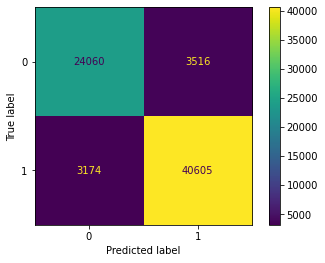

In [34]:
plot_confusion_matrix(clf, x_test, y_test)

In [35]:
24060/len(test_df), 40605/(len(test_df))

(0.33718730292200966, 0.569056127811646)

In [36]:
sum([24060/len(test_df), 40605/(len(test_df))])

0.9062434307336558

### Train Set

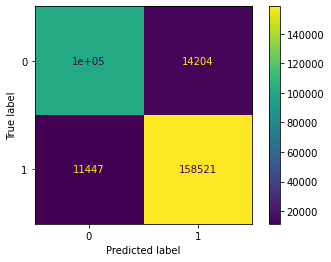

In [37]:
plot_confusion_matrix(clf, x_train, y_train)

### PvP

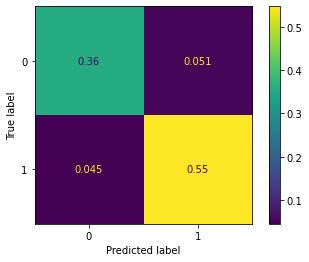

In [38]:
# test
plot_confusion_matrix(clf, x_test[pvp_test.index], 
                        y_test[pvp_test.index],
                        normalize='all')

### TvT

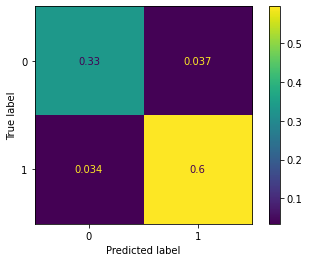

In [39]:
# test
plot_confusion_matrix(
    clf,
    x_test[tvt_test.index],
    y_test[tvt_test.index],
    normalize='all'
)

### ZvZ

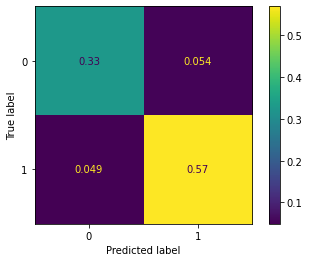

In [40]:
# test
plot_confusion_matrix(
    clf,
    x_test[zvz_test.index],
    y_test[zvz_test.index],
    normalize='all'
)

### TvP

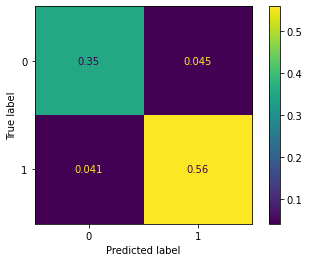

In [41]:
# test
plot_confusion_matrix(
    clf,
    x_test[tvp_test.index],
    y_test[tvp_test.index],
    normalize='all'
)

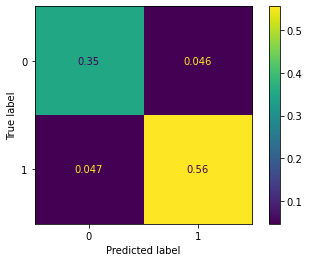

In [42]:
# test
plot_confusion_matrix(
    clf,
    x_test[tvz_test.index],
    y_test[tvz_test.index],
    normalize='all'
)

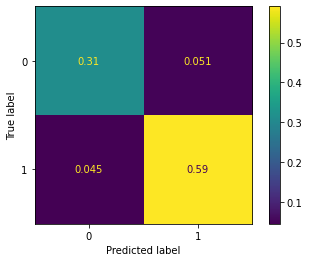

In [43]:
# test
plot_confusion_matrix(
    clf,
    x_test[zvp_test.index],
    y_test[zvp_test.index],
    normalize='all'
)

## Random score checks

In [44]:
f1_score(test_preds_res[zvz_test.index], y_test[zvz_test.index])

0.9167457132433419

In [45]:
matthews_corrcoef(test_preds_res[zvz_test.index], y_test[zvz_test.index])

0.7802418024307791

In [46]:
matthews_corrcoef(train_preds_res[zvz_train.index], y_train[zvz_train.index])

0.7875820959604665

In [47]:
f1_score(train_preds_res[zvz_train.index], y_train[zvz_train.index])

0.9174476611910078

In [48]:
f1_score(train_preds_res[close_train_preds_idx], y_train[close_train_preds_idx])

0.5612364760432765

In [49]:
accuracy_score(train_preds_res[close_train_preds_idx], y_train[close_train_preds_idx])

0.5563265816454114

## Ratings difference

<AxesSubplot:>

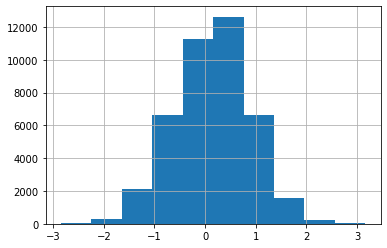

In [50]:
test_df[
    test_df['ratings_diff'].abs() < 5
]['ratings_diff'].hist()

<AxesSubplot:>

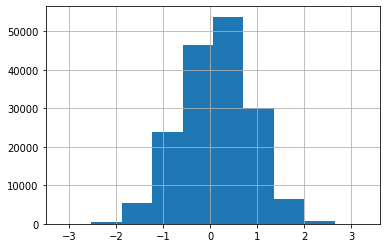

In [51]:
train_df[
    train_df['ratings_diff'].abs() < 5
]['ratings_diff'].hist()

This being normally distributed both ways is encouraging.

## Prediction probability closeness

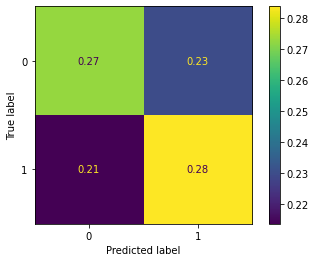

In [52]:

plot_confusion_matrix(
    clf,
    x_train[close_train_preds_idx],
    y_train[close_train_preds_idx],
    normalize='all'
)

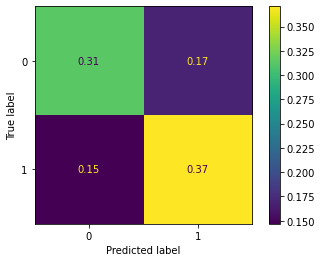

In [53]:

plot_confusion_matrix(
    clf,
    x_train[med_train_preds_idx],
    y_train[med_train_preds_idx],
    normalize='all'
)

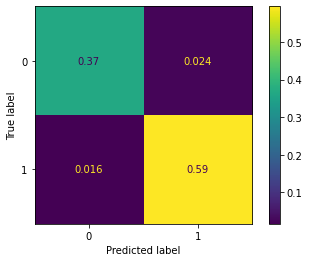

In [54]:

plot_confusion_matrix(
    clf,
    x_train[sure_train_preds_idx],
    y_train[sure_train_preds_idx],
    normalize='all'
)

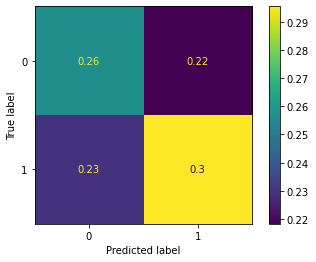

In [55]:
# test
plot_confusion_matrix(
    clf,
    x_test[close_test_preds_idx],
    y_test[close_test_preds_idx],
    normalize='all'
)

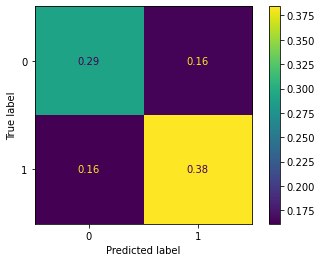

In [56]:
# test
plot_confusion_matrix(
    clf,
    x_test[med_test_preds_idx],
    y_test[med_test_preds_idx],
    normalize='all'
)

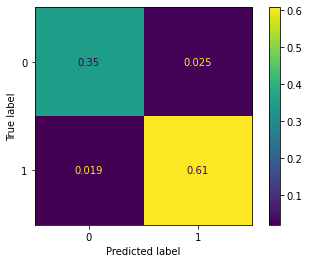

In [57]:
# test
plot_confusion_matrix(
    clf,
    x_test[sure_test_preds_idx],
    y_test[sure_test_preds_idx],
    normalize='all'
)

## EDA where model is unsure

In [58]:
close_train_preds_df = train_df.iloc[close_train_preds_idx]
close_test_preds_df = test_df.iloc[close_test_preds_idx]

In [59]:
len(close_train_preds_df)

15996

In [60]:
len(close_test_preds_df)

3994

In [61]:
close_train_preds_df.head(n=10)

,match_id,period_id,pla_id,plb_id,score_a,score_b,race_a,race_b,comp_rat_a,comp_rat_vp_a,...,pla_race_P,pla_race_T,pla_race_Z,plb_race_P,plb_race_T,plb_race_Z,pla_eff_rating,plb_eff_rating,ratings_diff,winner
2,204373,168,61,4551,0,2,Z,Z,-1000.000000,-1000.000000,...,0,0,1,0,0,1,0.121870,0.525932,-0.404062,0
13,204250,168,5847,6937,1,2,Z,Z,1.322775,1.835904,...,0,0,1,0,0,1,1.207825,1.255324,-0.047500,0
16,204722,168,5499,5118,3,2,P,T,0.969122,1.271496,...,1,0,0,0,1,0,0.723523,0.962539,-0.239016,1
58,204669,168,11648,8676,1,3,T,P,0.462175,0.552440,...,0,1,0,1,0,0,0.552440,0.773792,-0.221352,0
71,204917,168,1192,6235,3,1,Z,P,0.766892,0.641912,...,0,0,1,1,0,0,0.641912,0.751128,-0.109215,1
75,204836,168,6040,5590,2,1,T,T,0.185018,0.178023,...,0,1,0,0,1,0,-0.086987,0.163442,-0.250429,1
129,204279,168,462,451,1,2,T,T,-1000.000000,-2000.000000,...,0,1,0,0,1,0,0.392166,0.383080,0.009086,0
133,204633,168,112,10729,0,1,P,T,0.172822,0.439252,...,1,0,0,0,1,0,-0.040064,0.191887,-0.231952,0
147,203668,168,9237,9087,3,2,P,T,-1000.000000,-3000.000000,...,1,0,0,0,1,0,0.669751,0.481441,0.188310,1
153,204314,168,11434,4388,1,0,P,Z,-1000.000000,-3000.000000,...,1,0,0,0,0,1,0.869225,0.649359,0.219866,1


<AxesSubplot:>

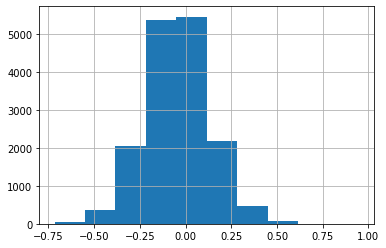

In [62]:
close_train_preds_df[
    close_train_preds_df['ratings_diff'].abs() < 5
]['ratings_diff'].hist()

In [63]:
len(close_train_preds_df[
    close_train_preds_df['plb_eff_rating'].abs() > 5
])

1

<AxesSubplot:>

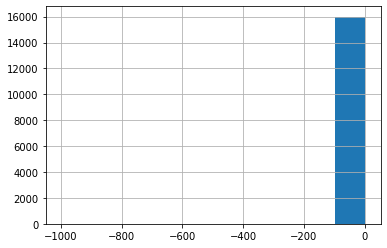

In [64]:
close_train_preds_df['pla_eff_rating'].hist()

<AxesSubplot:>

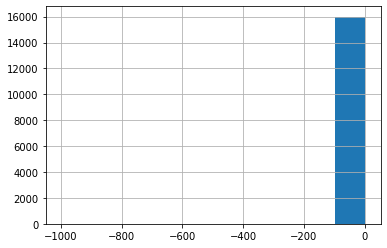

In [65]:
close_train_preds_df['plb_eff_rating'].hist()

In [66]:
close_train_preds_df.sort_values(by='pla_eff_rating', ascending=True)

,match_id,period_id,pla_id,plb_id,score_a,score_b,race_a,race_b,comp_rat_a,comp_rat_vp_a,...,pla_race_P,pla_race_T,pla_race_Z,plb_race_P,plb_race_T,plb_race_Z,pla_eff_rating,plb_eff_rating,ratings_diff,winner
149639,132046,125,1006,8254,0,0,P,P,-1000.000000,-1000.000000,...,1,0,0,1,0,0,-1000.000000,-1000.000000,0.000000,0
72894,268851,213,16482,7221,0,1,T,T,-1000.000000,-3000.000000,...,0,1,0,0,1,0,-1.241718,-1.110903,-0.130815,0
99348,290280,226,17158,10117,2,0,T,T,-1000.000000,-3000.000000,...,0,1,0,0,1,0,-1.080938,-0.945803,-0.135135,1
78908,272195,215,14756,16226,0,1,T,T,-1000.000000,-3000.000000,...,0,1,0,0,1,0,-1.042259,-0.940730,-0.101529,0
261668,335579,263,18754,20140,1,2,P,P,-1000.000000,-1.036994,...,1,0,0,1,0,0,-1.036994,-0.973921,-0.063073,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
87352,321156,250,1660,5,1,1,Z,P,1.728116,2.395456,...,0,0,1,1,0,0,2.395456,2.224186,0.171270,0
274602,344969,267,5878,5847,0,2,T,Z,2.186655,2.225183,...,0,1,0,0,0,1,2.435728,2.145541,0.290187,0
124933,361577,276,177,5414,3,4,P,Z,2.266395,2.271175,...,1,0,0,0,0,1,2.435916,2.119907,0.316008,0
126140,363250,277,1662,2170,1,2,Z,P,-1000.000000,2.487286,...,0,0,1,1,0,0,2.487286,2.188294,0.298992,0


In [67]:
close_train_preds_df[
    close_train_preds_df['pla_eff_rating'] < -5
]

,match_id,period_id,pla_id,plb_id,score_a,score_b,race_a,race_b,comp_rat_a,comp_rat_vp_a,...,pla_race_P,pla_race_T,pla_race_Z,plb_race_P,plb_race_T,plb_race_Z,pla_eff_rating,plb_eff_rating,ratings_diff,winner
149639,132046,125,1006,8254,0,0,P,P,-1000.0,-1000.0,...,1,0,0,1,0,0,-1000.0,-1000.0,0.0,0


In [68]:
sure_train_preds_df = train_df.iloc[sure_train_preds_idx]

sure_train_preds_df.head(n=10)

,match_id,period_id,pla_id,plb_id,score_a,score_b,race_a,race_b,comp_rat_a,comp_rat_vp_a,...,pla_race_P,pla_race_T,pla_race_Z,plb_race_P,plb_race_T,plb_race_Z,pla_eff_rating,plb_eff_rating,ratings_diff,winner
0,204283,168,422,2102,3,1,Z,P,1.362724,1.472933,...,0,0,1,1,0,0,1.472933,1.023097,0.449836,1
1,204881,168,962,12662,1,0,Z,Z,-1000.000000,0.067802,...,0,0,1,0,0,1,0.155740,0.169566,-0.013826,1
3,24883,2,208,1218,4,2,Z,P,-1000.000000,0.376888,...,0,0,1,1,0,0,0.376888,-0.391791,0.768680,1
4,205013,168,1100,10298,2,1,T,Z,0.975380,1.661578,...,0,1,0,0,0,1,0.498680,-0.364031,0.862712,1
5,204205,168,6018,5437,0,1,P,P,-1000.000000,-3000.000000,...,1,0,0,1,0,0,-3000.000000,0.393580,-3000.393580,0
6,204176,168,13236,6018,0,1,Z,P,-1000.000000,-0.295511,...,0,0,1,1,0,0,-0.295511,-2000.000000,1999.704489,0
7,204166,168,7527,11595,1,0,Z,T,-1000.000000,-3000.000000,...,0,0,1,0,1,0,-2000.000000,-3000.000000,1000.000000,1
8,203666,168,8218,8023,0,2,Z,T,-1000.000000,-1000.000000,...,0,0,1,0,1,0,-0.185765,0.032472,-0.218237,0
9,204287,168,5118,10800,2,0,T,T,0.964279,0.962539,...,0,1,0,0,1,0,0.822710,-3000.000000,3000.822710,1
11,205111,168,5118,9750,2,0,T,Z,0.964279,0.962539,...,0,1,0,0,0,1,1.107589,0.213839,0.893751,1


<AxesSubplot:>

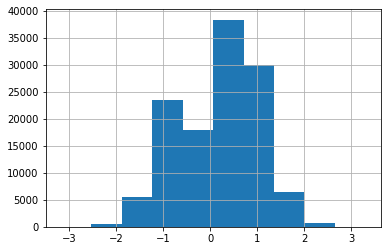

In [69]:
sure_train_preds_df[
    sure_train_preds_df['ratings_diff'].abs() < 5
]['ratings_diff'].hist()

In [70]:
sure_train_preds_df.sort_values(by='ratings_diff')[sure_train_preds_df['ratings_diff'].abs() < 1]

/home/specc/Documents/school_files/thesis/tourney_sim_project/lib/python3.7/site-packages/ipykernel_launcher.py:1: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



,match_id,period_id,pla_id,plb_id,score_a,score_b,race_a,race_b,comp_rat_a,comp_rat_vp_a,...,pla_race_P,pla_race_T,pla_race_Z,plb_race_P,plb_race_T,plb_race_Z,pla_eff_rating,plb_eff_rating,ratings_diff,winner
21247,354231,272,13145,87,0,2,P,Z,-1000.000000,-3000.000000,...,1,0,0,0,0,1,0.311072,1.311057,-0.999985,0
97307,288115,225,15815,15820,1,2,T,T,-1000.000000,-2000.000000,...,0,1,0,0,1,0,-0.341312,0.658667,-0.999979,0
212583,1120,70,106,128,2,1,T,P,-1000.000000,-0.113349,...,0,1,0,1,0,0,-0.113349,0.886592,-0.999941,1
159152,143331,131,5111,214,0,2,P,P,-0.168774,-0.413822,...,1,0,0,1,0,0,-0.413822,0.586087,-0.999909,0
52265,123044,121,8130,2575,0,2,T,P,-1000.000000,-0.647117,...,0,1,0,1,0,0,-0.647117,0.352747,-0.999864,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
246774,324297,252,1665,1658,3,1,T,P,2.010020,2.421839,...,0,1,0,1,0,0,2.421839,1.422153,0.999685,1
33650,110415,113,267,110,3,1,T,P,-1000.000000,1.016356,...,0,1,0,1,0,0,1.016356,0.016592,0.999764,1
10952,24037,14,156,180,2,0,T,P,0.878737,0.913972,...,0,1,0,1,0,0,0.913972,-0.085858,0.999830,1
195336,314752,244,1658,1517,3,0,P,T,-1000.000000,-3000.000000,...,1,0,0,0,1,0,1.697446,0.697556,0.999890,1


In [71]:
sure_train_preds_df['period_id'].unique()

array([168,   2,   6,   3,  18,  14,   4,  29,  15,  45,   5,  20,   8,
        10,   7,  17,  25,  11,  24,  40,  46,  19,  23,  26,  22,  31,
        33, 205, 113, 169, 278, 188, 262, 274,  94,  21, 170, 171,  16,
       172,   1, 258,  27,  48,  60,  47,  28,  39,  41,  44,  35,  37,
       173,  56,  58,  32,  49,  50,  54,  34,  36,  42, 273, 252, 206,
        12,  13,  43,  96, 259, 266, 261, 263, 207,  30, 270, 271, 230,
       195,  52, 196, 279, 180, 280, 150, 264, 197, 198, 174, 175, 281,
       199,  38, 265, 208, 282, 200, 220, 201, 272, 209, 202, 203, 243,
       244, 176, 153, 177, 154, 178, 155, 204, 245, 246, 114, 146, 149,
       151, 152, 167, 130, 134, 144, 156,  98,  99, 110, 147, 148, 112,
       119, 120, 121, 123, 127, 128, 136, 138, 139, 140, 141, 145, 158,
       159, 160, 166, 179, 157,  93, 115,  95, 116, 117,  97, 118, 210,
       268, 101, 109, 122, 124, 105, 181, 182, 183, 184, 111, 185, 211,
       186, 212, 187, 213, 214,  62, 189, 215, 190, 247, 232, 24

In [72]:
close_train_preds_df['period_id'].unique()

array([168,  18,  23,  50, 205, 169,  94,   4,  20, 170, 113, 171,  17,
       188,   7, 172,  24,  16,   1,  60, 173,  54,  25,  45,  49, 258,
         5, 206,   6, 262,  11,  12,  13,   2,  14, 266, 207,  10, 230,
        26, 195, 270,  21, 263,  27, 196, 278, 220,  22,  42, 197,  28,
       174,  32, 175, 198, 282, 264,  19, 253, 208,  15, 199,  29, 200,
       265,  31, 201, 272, 279,  43, 209,  30, 273, 281, 203, 243, 244,
        34, 176, 153, 177, 178,  38, 245,  33, 246, 154, 204, 179, 157,
       114, 115, 116, 117,  41,  37, 118, 180, 119,  35, 120, 210,   3,
       121,  55, 141, 122, 123, 124, 155, 181, 182, 183, 110, 184, 111,
       112, 211, 185, 212, 186, 213, 214, 215, 156, 247, 248, 231, 249,
       190, 216, 191, 217, 192, 274, 250, 194, 218,  36, 219, 222, 221,
       251, 223, 224, 225,  39, 226, 227, 228, 229, 189, 165, 232, 233,
       167, 234, 267, 235, 236, 237, 238, 239,  44, 252, 240, 241, 275,
       254, 268, 276, 256, 277, 269, 257, 259,  46, 125, 242, 28

In [73]:
# Look between -1 and 1
# compare to global